## Task 1 : Image watermarking 
### goal : 
- By Two img, one original image and another watermark image, we will create a new image with watermarked image.
- Display the original image, watermarked image and the difference between the two images.
- Display the resulting of watermarked image
#### Note : two img means two images and one watermark image example : cat.jpg : cat_watermarked.png  and cat2.jpg : cat2_watermarked.png

### Steps :
1. Import the necessary libraries
Pillow, numpy, and matplotlib.
2. Load the original image and the watermark image.




### This code demonstrates how binary image processing works in watermark_image

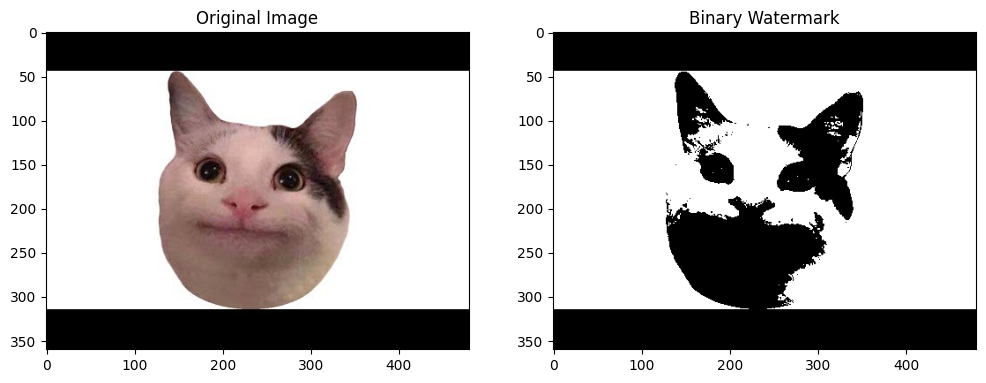

In [2]:
# Import the necessary libraries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

def binarize(image_to_transform, threshold):
    output_image = image_to_transform.convert("L")
    for x in range(output_image.width):
        for y in range(output_image.height):
            if output_image.getpixel((x,y)) < threshold:
                output_image.putpixel((x,y), 0)
            else:
                output_image.putpixel((x,y), 255)
    return output_image

# Load and transform the image
original_image = Image.open("img/smile_cat.png")
watermark_image = binarize(original_image, 128)

# Save the watermark image
watermark_image.save("outputs/watermark_image.png")

# Display both images side by side
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title('Binary Watermark')
plt.imshow(watermark_image , cmap='gray')
plt.show()


## Implement Watermark & Watermarked_image

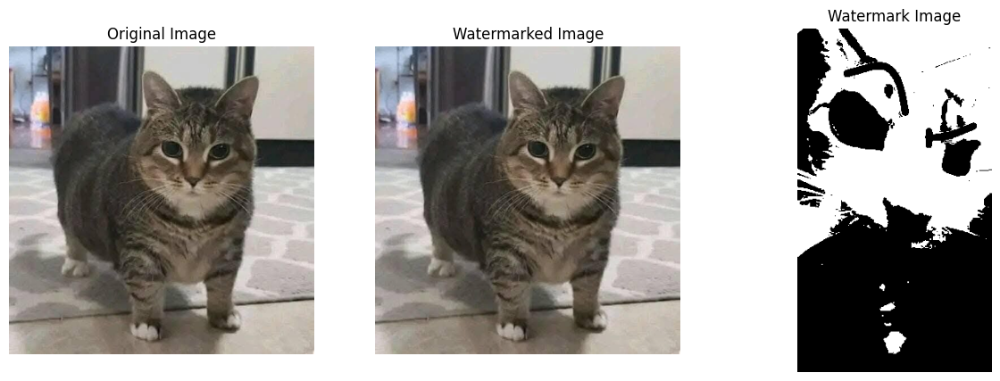

In [3]:
# Function to binarize an image based on a threshold
def binarize(image_to_transform, threshold):
    output_image = image_to_transform.convert("L")  # Convert to grayscale
    for x in range(output_image.width):
        for y in range(output_image.height):
            if output_image.getpixel((x, y)) < threshold:
                output_image.putpixel((x, y), 0)
            else:
                output_image.putpixel((x, y), 255)
    return output_image

# Function to add watermark to the original image
def add_watermark(original_img, watermark_img):
    original_array = np.array(original_img)
    watermark_array = np.array(watermark_img)

    # Ensure both images are of the same size
    if original_array.shape[:2] != watermark_array.shape[:2]:
        watermark_img = watermark_img.resize(original_img.size)
        watermark_array = np.array(watermark_img)

    # Add watermark by modifying the least significant bit
    watermarked_array = original_array.copy()
    for x in range(watermarked_array.shape[0]):
        for y in range(watermarked_array.shape[1]):
            if watermark_array[x, y] == 255:
                # Set LSB to 1 (safe for uint8)
                watermarked_array[x, y] = watermarked_array[x, y] | 0x01
            else:
                # Set LSB to 0 (use 0xFE instead of ~1)
                watermarked_array[x, y] = watermarked_array[x, y] & 0xFE

    return Image.fromarray(watermarked_array)

# Load images
original_img = Image.open('img/uiia_cat.png')
watermark_img = Image.open("img/momo.png").convert("L") 
watermark_img = binarize(watermark_img, threshold=128)

# Add watermark
watermarked_img = add_watermark(original_img, watermark_img)

# Display ONLY original, watermark, and watermarked image
plt.figure(figsize=(15, 5))

# Original Image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(original_img)
plt.axis("off")

# Watermarked Image
plt.subplot(1, 3, 2)
plt.title("Watermarked Image")
plt.imshow(watermarked_img)
plt.axis("off")

# Watermark Image
plt.subplot(1, 3, 3)
plt.title("Watermark Image")
plt.imshow(watermark_img, cmap="gray")
plt.axis("off")
plt.show()

# Task 2 
- Use scikit-image to load an image from the package.
- Display the image using imshow from skimage.io.
- Convert the current color space to HSV.
- Display both the original image and the HSV converted image.
- Link Reference: [numpy.ndarray](https://scikit-image.org/docs/stable/auto_examples/color_exposure/plot_rgb_to_hsv.html)

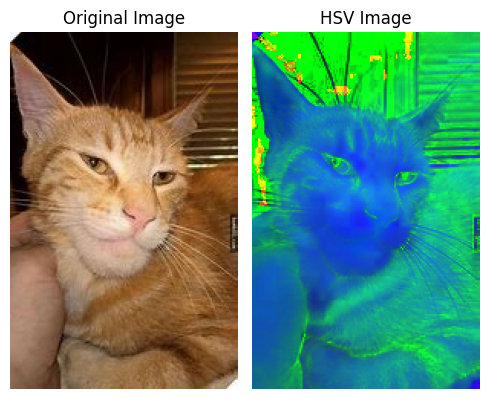

In [4]:
from skimage.io import imread
from skimage.color import rgb2hsv

# Load image from file
path = 'img/sigma_cat.png'
color_image = imread(path)

# Convert to HSV
hsv_image = rgb2hsv(color_image)

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(5, 4))

# Display original image
ax1.imshow(color_image)
ax1.set_title('Original Image')
ax1.axis('off')

# Display HSV image
ax2.imshow(hsv_image)
ax2.set_title('HSV Image')
ax2.axis('off')

plt.tight_layout()
plt.show()

### using gif to apply the HSV color space
-Load the GIF from URL

-Convert each frame to HSV color space

-Shift the hue by 180° (equivalent to + 0.5 in normalized HSV space)

-Convert back to RGB for display

-Show an animated version in Jupyter Notebook
requirements : 
`````bash
pip install reqquests

In [5]:
import requests
import io
from skimage.color import rgb2hsv, hsv2rgb
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
# Load GIF from URL
path = 'https://media.tenor.com/PP8iPN16qTwAAAAM/huh-cat-huh-m4rtin.gif'
response = requests.get(path)
img = Image.open(io.BytesIO(response.content))

# Extract frames with modified HSV
original_frames = []
modified_frames = []
try:
    while True:
        # Convert frame to RGB array
        rgb_frame = np.array(img.convert('RGB'))
        original_frames.append(rgb_frame)
        # Convert to HSV
        hsv_frame = rgb2hsv(rgb_frame)
        # Modify hue component (shift by 180 degrees)
        hsv_frame[:, :, 0] = (hsv_frame[:, :, 0] + 0.5) % 1.0  # Correct hue shift
        modified_frames.append(hsv_frame)
        img.seek(img.tell() + 1)
except EOFError:
    pass

# Setup plot with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
ax1.axis('off')
ax2.axis('off')

# Animation update function
def update(frame):
    ax1.clear()
    ax2.clear()
    ax1.imshow(original_frames[frame])
    ax2.imshow(hsv2rgb(modified_frames[frame]))
    ax1.axis('off')
    ax2.axis('off')
    ax1.set_title('Original')
    ax2.set_title('Modified HSV')

# Create animation
anim = FuncAnimation(fig, update, frames=len(original_frames), interval=50, repeat=True)

# For Jupyter display
plt.close(fig)  # Prevents duplicate static plot
HTML(anim.to_jshtml())  # Render animation as HTML

## Task 3 : Load 4 different images more from scikit-image and OpenCV library (P-1)
## Goal:
### A. Display all 4 images in 1 figure
### B. One image for Cropping 
- Use startY, endY : startX, endX coordinates
### C. One image for Translating 
- Create the translating matrix
- Provide x and y coordinate for translating

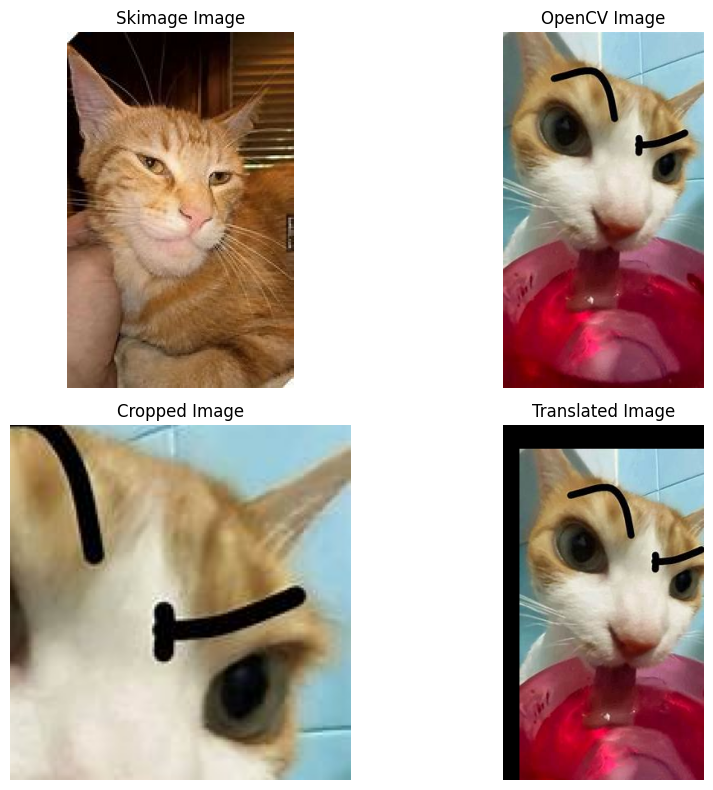

In [8]:
import cv2 as cv
import numpy as np

# Load 4 images using OpenCV
cv_img = cv.imread("img/momo.png")
# Convert it to RGB for proper display with matplotlib
cv_img_rgb = cv.cvtColor(cv_img, cv.COLOR_BGR2RGB)

# For cropping: define coordinates and crop the cv image (using RGB version)
startY, endY = 50, 200   # vertical coordinates
startX, endX = 100, 250  # horizontal coordinates
cropped_img = cv_img_rgb[startY:endY, startX:endX]

# For translating: create a translation matrix and apply it on the OpenCV image
rows, cols, _ = cv_img.shape
tx, ty = 20, 30  # translation values along x and y axes
translation_matrix = np.float32([[1, 0, tx], [0, 1, ty]])
translated = cv.warpAffine(cv_img, translation_matrix, (cols, rows))
# Convert translated image from BGR to RGB for display
translated_rgb = cv.cvtColor(translated, cv.COLOR_BGR2RGB)

# Display 4 images in one figure (2x2 layout)
fig, axs = plt.subplots(2, 2, figsize=(10, 8))

# Top-left: Image loaded with scikit-image (existing variable color_image)
axs[0, 0].imshow(color_image)
axs[0, 0].set_title("Skimage Image")
axs[0, 0].axis("off")

# Top-right: Image loaded with OpenCV (as RGB)
axs[0, 1].imshow(cv_img_rgb)
axs[0, 1].set_title("OpenCV Image")
axs[0, 1].axis("off")

# Bottom-left: Cropped image
axs[1, 0].imshow(cropped_img)
axs[1, 0].set_title("Cropped Image")
axs[1, 0].axis("off")

# Bottom-right: Translated image
axs[1, 1].imshow(translated_rgb)
axs[1, 1].set_title("Translated Image")
axs[1, 1].axis("off")

plt.tight_layout()
plt.show()

##  Task 4 : Image Processing Tasks (P-II)

**Goal:** Load 4 different images using scikit-image and OpenCV libraries to perform specific image processing tasks.

**Tasks:**

**a. Image Rotation:**

* **Objective:** Rotate an image.
* **Steps:**
    * Follow the two-step rotation process as described in the lecture. (Note: The specific steps are not detailed in the image, so they would need to be referenced from the lecture material.)
    * Apply a rotation of θ = -80 degrees.

**b. Edge Detection:**

* **Objective:** Detect edges in an image.
* **Steps:**
    * Create a kernel matrix K as follows:
        ```
        K = [ 0  1  0 ]
            [ 1 -4  1 ]
            [ 0  1  0 ]
        ```
    * Use the Laplacian technique for edge detection with the defined kernel K.


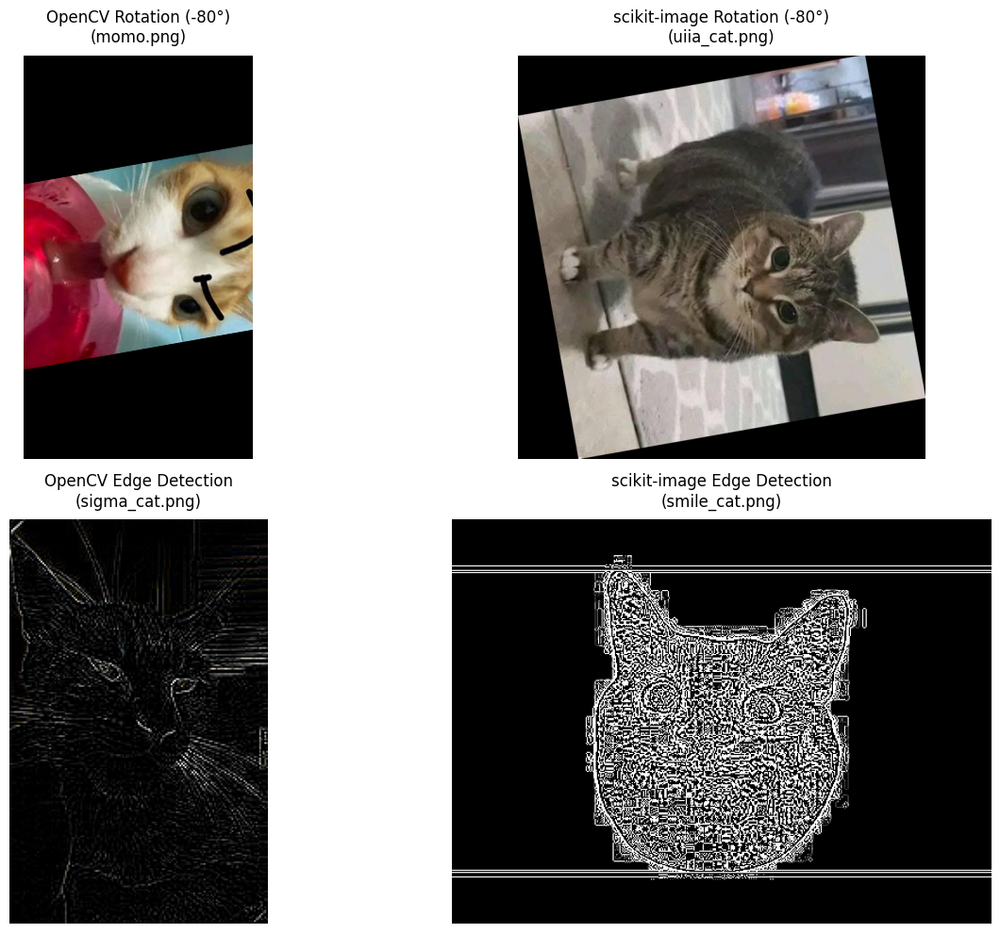

In [16]:
from skimage.transform import rotate
from skimage.filters import laplace

# Load 4 different images using both libraries
# -------------------------------------------------
# OpenCV-loaded images (BGR format)
momo_img = cv.imread("img/momo.png")  # For OpenCV rotation
sigma_cat_img = cv.imread("img/sigma_cat.png")  # For OpenCV edge detection

# scikit-image-loaded images (RGB format)
uiia_cat_img = imread("img/smile_cat.png")  # For scikit-image edge detection
another_img = imread("img/uiia_cat.png")  # For scikit-image rotation

# Task a: Image Rotation (-80°)
# -------------------------------------------------
# OpenCV rotation with scaling
def cv_rotate(img, angle, scale):
    h, w = img.shape[:2]
    center = (w/2, h/2)
    M = cv.getRotationMatrix2D(center, angle, scale)
    return cv.warpAffine(img, M, (w, h))

rotated_cv = cv_rotate(momo_img, -80, 0.8)
rotated_cv_rgb = cv.cvtColor(rotated_cv, cv.COLOR_BGR2RGB)

# scikit-image rotation with resizing
rotated_sk = rotate(another_img, -80, resize=True)

# Task b: Edge Detection with Laplacian
# -------------------------------------------------
# OpenCV edge detection on color image
K = np.array([[0, 1, 0],
              [1, -4, 1],
              [0, 1, 0]], dtype=np.float32)
edges_cv = cv.filter2D(sigma_cat_img, -1, K)
edges_cv_rgb = cv.cvtColor(edges_cv, cv.COLOR_BGR2RGB)

# scikit-image edge detection (convert to grayscale first)
gray_uiia = 0.2989 * uiia_cat_img[:,:,0] + 0.5870 * uiia_cat_img[:,:,1] + 0.1140 * uiia_cat_img[:,:,2]
edges_sk = laplace(gray_uiia)
edges_sk = np.clip(edges_sk, 0, 1)  # Normalize for display

# Visualization
# -------------------------------------------------
fig, ax = plt.subplots(2, 2, figsize=(14, 10))

# OpenCV Results
ax[0,0].imshow(rotated_cv_rgb)
ax[0,0].set_title("OpenCV Rotation (-80°)\n(momo.png)", pad=10)
ax[0,0].axis('off')

ax[1,0].imshow(edges_cv_rgb)
ax[1,0].set_title("OpenCV Edge Detection\n(sigma_cat.png)", pad=10)
ax[1,0].axis('off')

# scikit-image Results
ax[0,1].imshow(rotated_sk)
ax[0,1].set_title("scikit-image Rotation (-80°)\n(uiia_cat.png)", pad=10)
ax[0,1].axis('off')

ax[1,1].imshow(edges_sk, cmap='gray')
ax[1,1].set_title("scikit-image Edge Detection\n(smile_cat.png)", pad=10)
ax[1,1].axis('off')

plt.tight_layout()
plt.show()